In [12]:
import os
import cooler
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np


In [13]:
cool_directory_c2_m1 = "/commons/groups/gursoy_lab/wlounsberyscaife/ML_poreC/scripts/python_scripts/factor_analysis/cool/data/poreC_cools_c2_m1"
output_base_dir_c2_m1 = "/commons/groups/gursoy_lab/wlounsberyscaife/ML_poreC/scripts/python_scripts/factor_analysis/cool/data/poreC_cools_c2_m1_transformed/"

cool_directory_c2_m2 = "/commons/groups/gursoy_lab/wlounsberyscaife/ML_poreC/scripts/python_scripts/factor_analysis/cool/data/poreC_cools_c2_m2"
output_base_dir_c2_m2 = "/commons/groups/gursoy_lab/wlounsberyscaife/ML_poreC/scripts/python_scripts/factor_analysis/cool/data/poreC_cools_c2_m2_transformed/"

cool_directory_c2_m3 = "/commons/groups/gursoy_lab/wlounsberyscaife/ML_poreC/scripts/python_scripts/factor_analysis/cool/data/poreC_cools_c2_m3"
output_base_dir_c2_m3 = "/commons/groups/gursoy_lab/wlounsberyscaife/ML_poreC/scripts/python_scripts/factor_analysis/cool/data/poreC_cools_c2_m3_transformed/"

cool_directory_c2_test = "/commons/groups/gursoy_lab/wlounsberyscaife/ML_poreC/scripts/python_scripts/factor_analysis/cool/data/poreC_cools_c2_test"
output_base_dir_c2_test = "/commons/groups/gursoy_lab/wlounsberyscaife/ML_poreC/scripts/python_scripts/factor_analysis/cool/data/poreC_cools_c2_test_transformed/"

In [14]:
def display_matrices(chromosome, cool_directory, output_base_dir, min_freq, og_vm):
    # define paths to cool files
    chrom_cool_path = os.path.join(cool_directory, f'NlaIII_GM12878_chr{chromosome}_tensor.cool')
    chrom_cool_path_obs_exp = os.path.join(output_base_dir, f'NlaIII_GM12878_chr{chromosome}_tensor_obs_exp.cool')
    chrom_cool_path_obs_exp_nonzero = os.path.join(output_base_dir, f'NlaIII_GM12878_chr{chromosome}_tensor_obs_exp_nonzero.cool')
    chrom_cool_path_obs_exp_lieberman = os.path.join(output_base_dir, f'NlaIII_GM12878_chr{chromosome}_tensor_obs_exp_lieberman.cool')
    chrom_cool_path_pearson = os.path.join(output_base_dir, f'NlaIII_GM12878_chr{chromosome}_tensor_pearson.cool')
    chrom_cool_path_covariance = os.path.join(output_base_dir, f'NlaIII_GM12878_chr{chromosome}_tensor_covariance.cool')

    # load cool files
    chrom_cool = cooler.Cooler(chrom_cool_path)
    chrom_cool_obs_exp = cooler.Cooler(chrom_cool_path_obs_exp)
    chrom_cool_obs_exp_nonzero = cooler.Cooler(chrom_cool_path_obs_exp_nonzero)
    chrom_cool_obs_exp_lieberman = cooler.Cooler(chrom_cool_path_obs_exp_lieberman)
    chrom_cool_pearson = cooler.Cooler(chrom_cool_path_pearson)
    chrom_cool_covariance = cooler.Cooler(chrom_cool_path_covariance)

    # Extract the interaction matrices
    matrix = chrom_cool.matrix(balance=False).fetch('chr' + chromosome)
    matrix_obs_exp = chrom_cool_obs_exp.matrix(balance=False).fetch('chr' + chromosome)
    matrix_obs_exp_nonzero = chrom_cool_obs_exp_nonzero.matrix(balance=False).fetch('chr' + chromosome)
    matrix_obs_exp_lieberman = chrom_cool_obs_exp_lieberman.matrix(balance=False).fetch('chr' + chromosome)
    matrix_pearson = chrom_cool_pearson.matrix(balance=False).fetch('chr' + chromosome)
    matrix_covariance = chrom_cool_covariance.matrix(balance=False).fetch('chr' + chromosome)

    # List of matrices and their titles
    matrices = [matrix, matrix_obs_exp, matrix_obs_exp_nonzero, matrix_obs_exp_lieberman, matrix_pearson, matrix_covariance]
    titles = ['Original', 'Obs/Exp', 'Obs/Exp Non-Zero', 'Obs/Exp Lieberman', 'Pearson', 'Covariance']

    # Number of matrices to plot
    num_matrices = 6

    # List of matrices and their titles
    matrices = [matrix, matrix_obs_exp, matrix_obs_exp_nonzero, matrix_obs_exp_lieberman, matrix_pearson, matrix_covariance]
    titles = ['Original', 'Obs/Exp', 'Obs/Exp Non-Zero', 'Obs/Exp Lieberman', 'Pearson', 'Covariance']

    # Create a figure with subplots
    fig, axs = plt.subplots(2, 3, figsize=(15, 10))

    # Loop through each matrix and plot it using seaborn heatmap
    for i, matrix in enumerate(matrices):
        ax = axs[i // 3, i % 3]  # Get the correct subplot
        
        # Determine vmax dynamically for non-original matrices
        vmax = og_vm if i == 0 else np.percentile(np.abs(matrices[i]), 99)
        
        # Plot the heatmap with seaborn
        sns.heatmap(matrix, ax=ax, cmap='YlGnBu', vmax=vmax)

        # Invert the y-axis to start from 0 at the bottom
        ax.invert_yaxis()
        
        ax.set_title(titles[i])
        ax.set_xlabel('Position')
        ax.set_ylabel('Position')

    # supertitle to indicate chromosome
    fig.suptitle(f'Chromosome {chromosome} Pore-C Matrices, card 2, min_freq={min_freq}', fontsize=14)
    
    # Adjust the layout and display the plot
    plt.tight_layout(rect=[0, 0.03, 1, 0.95]) 
    plt.show()

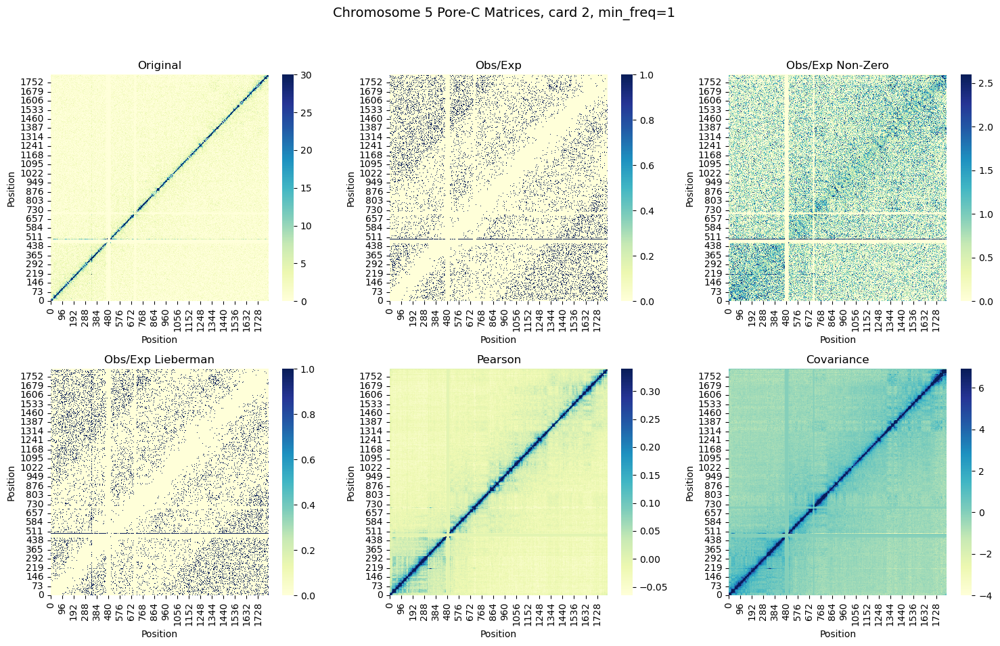

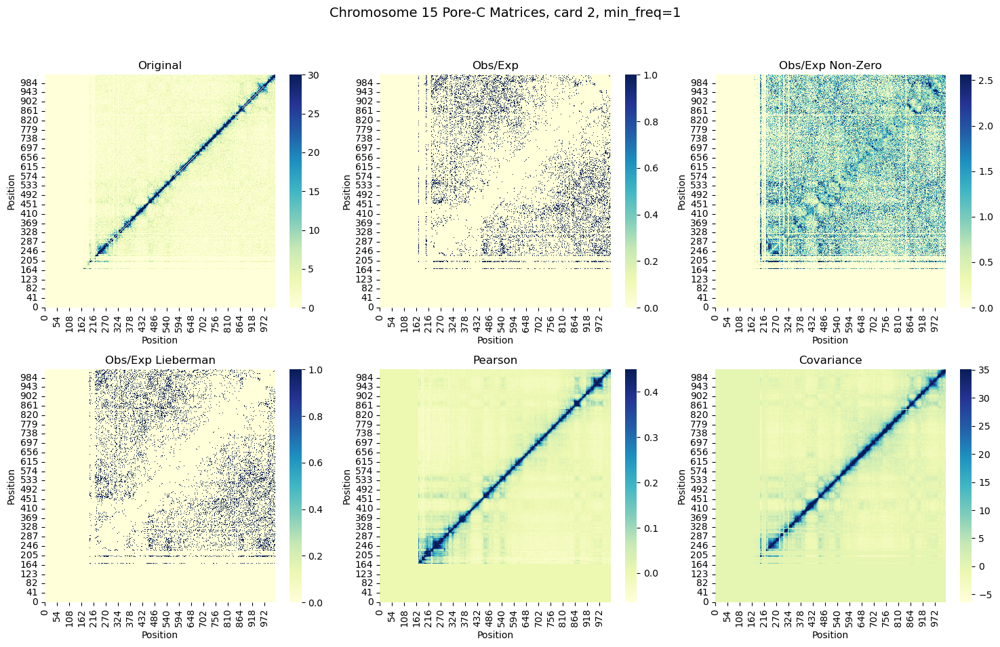

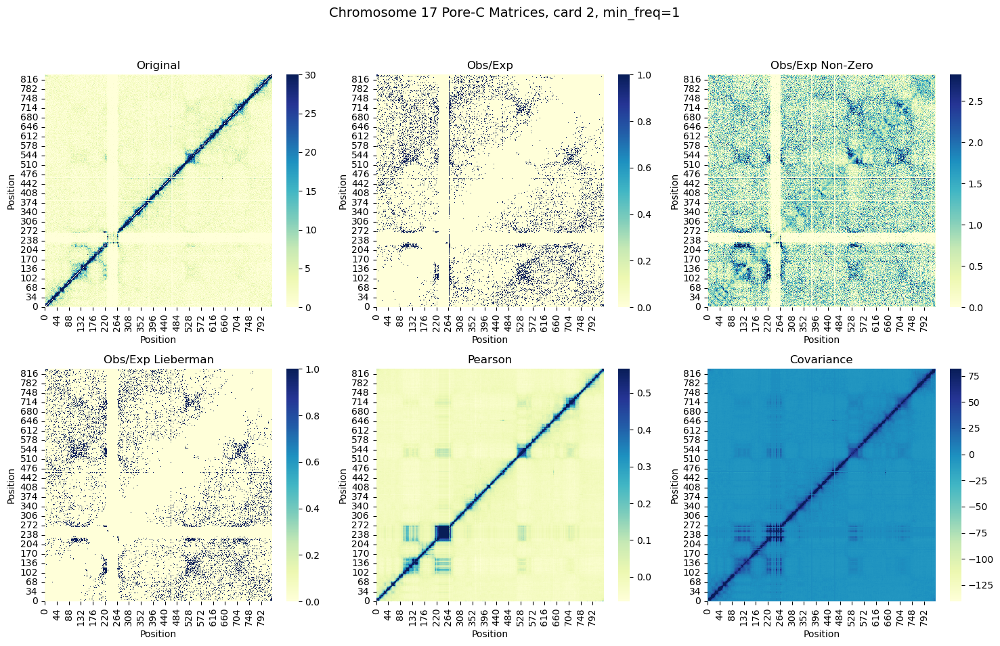

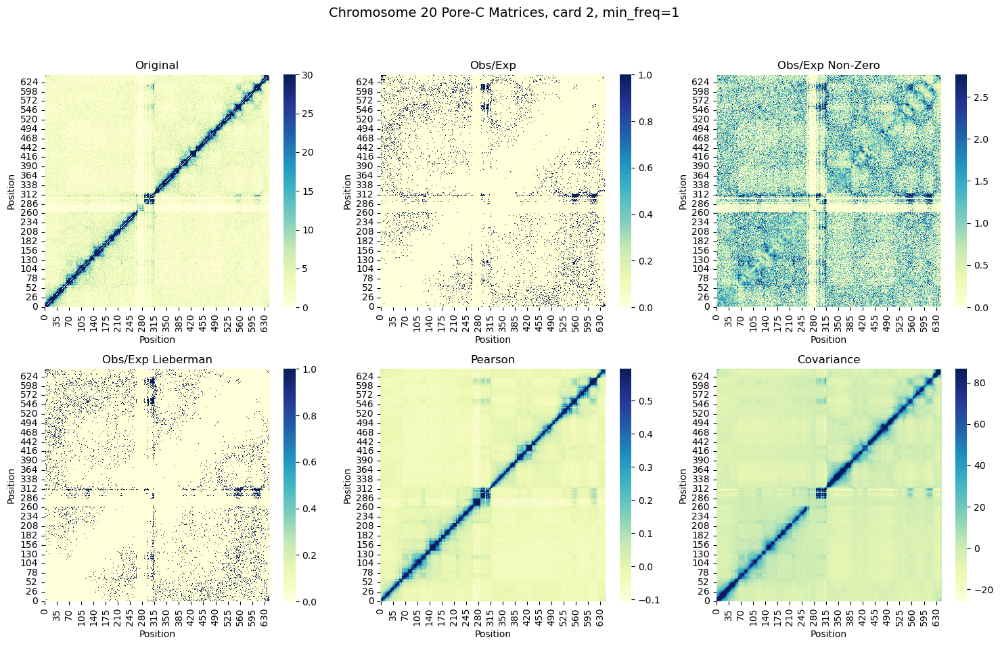

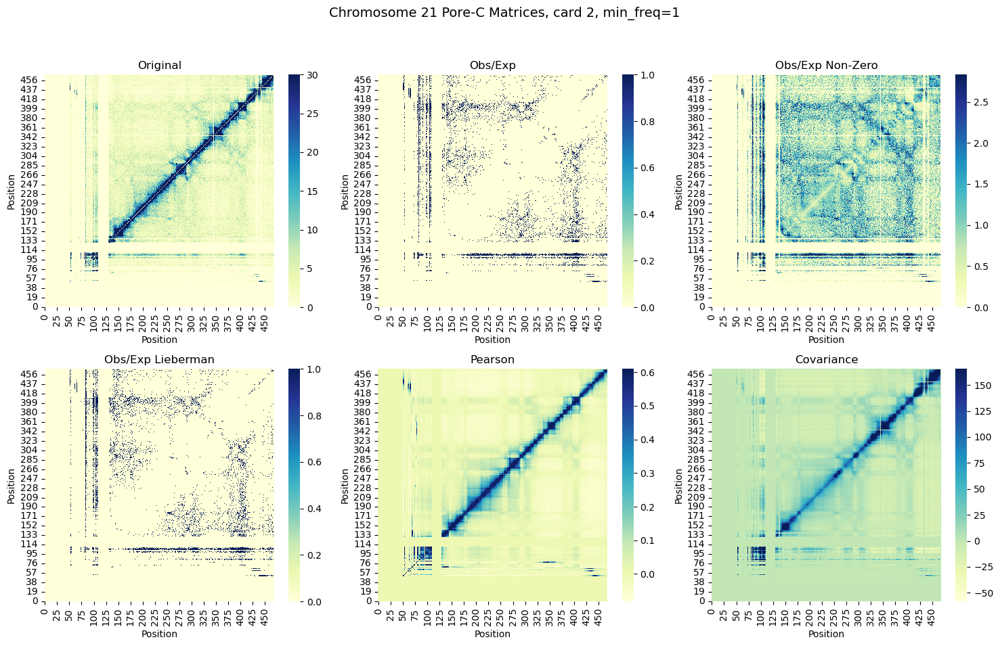

In [15]:
chromosomes = ["5", "15", "17", "20", "21"]
for chromosome in chromosomes:
    display_matrices(chromosome, cool_directory_c2_m1, output_base_dir_c2_m1, 1, 30)

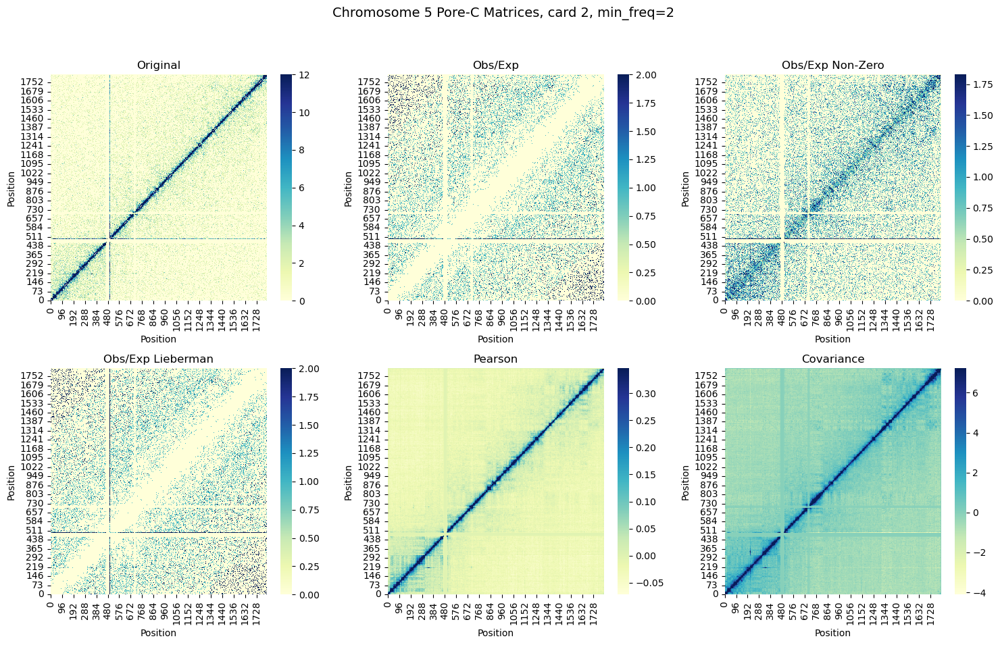

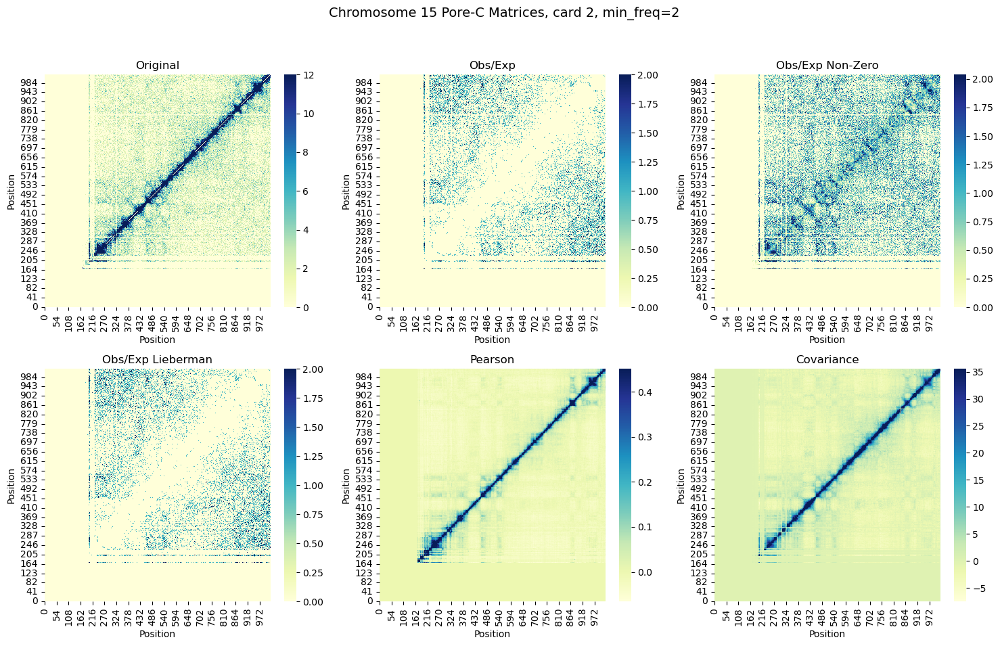

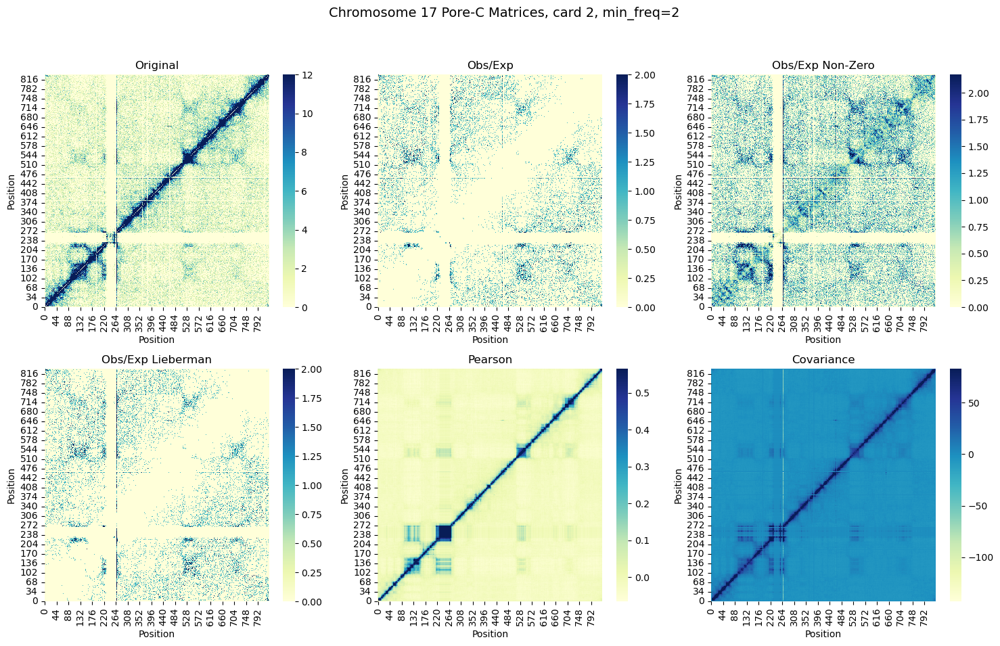

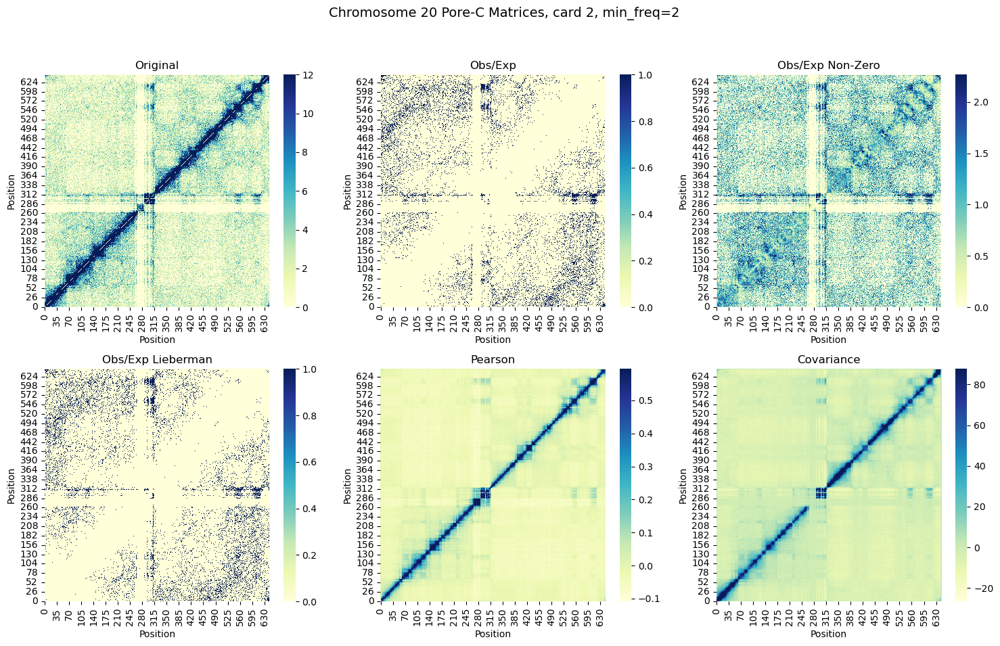

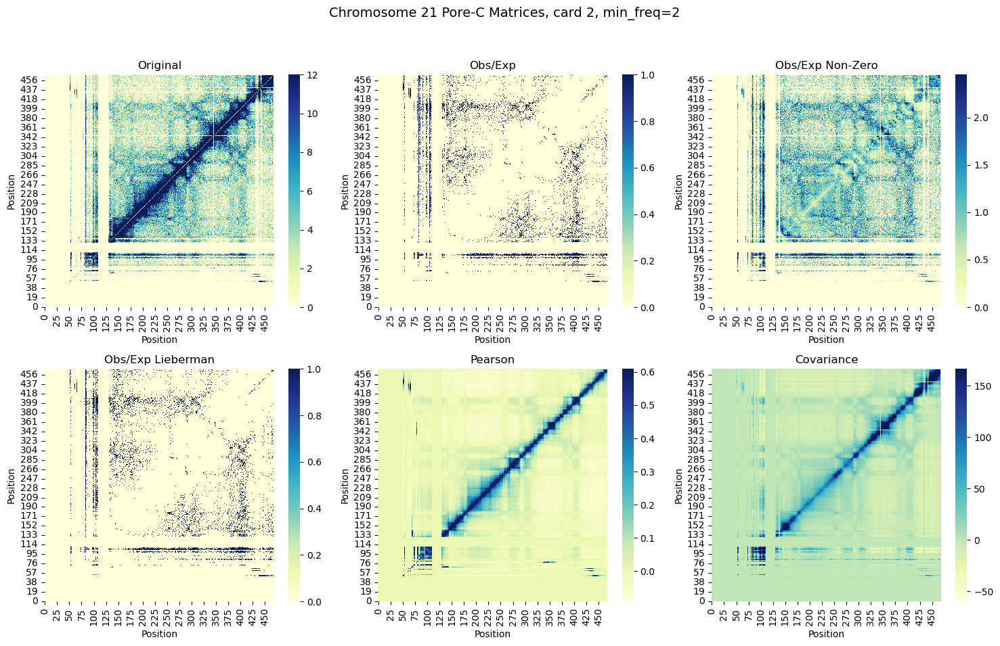

In [16]:
for chromosome in chromosomes:
    display_matrices(chromosome, cool_directory_c2_m2, output_base_dir_c2_m2, 2, 12)

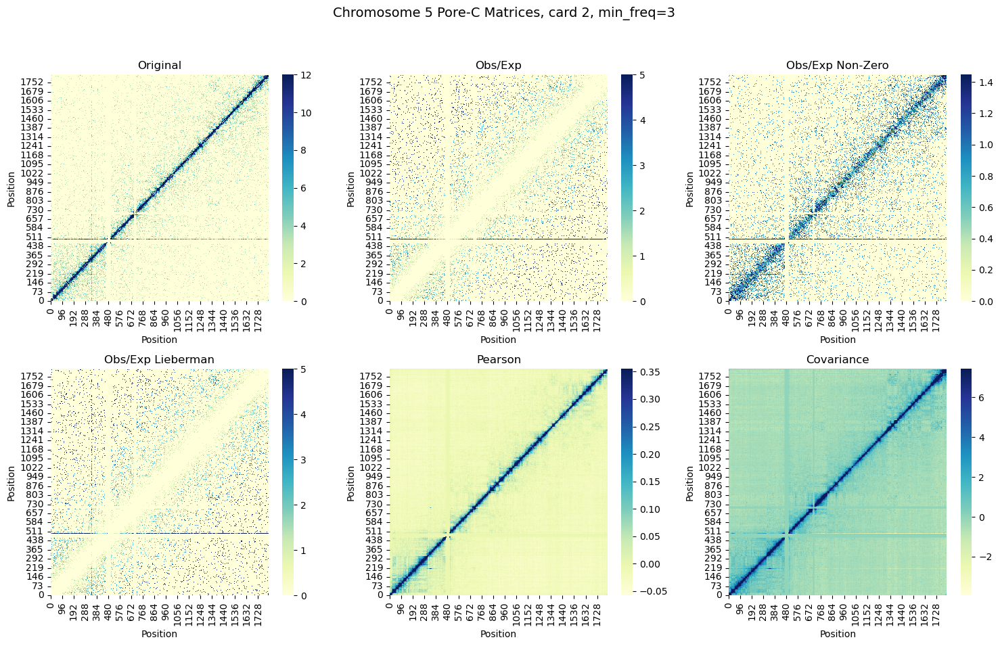

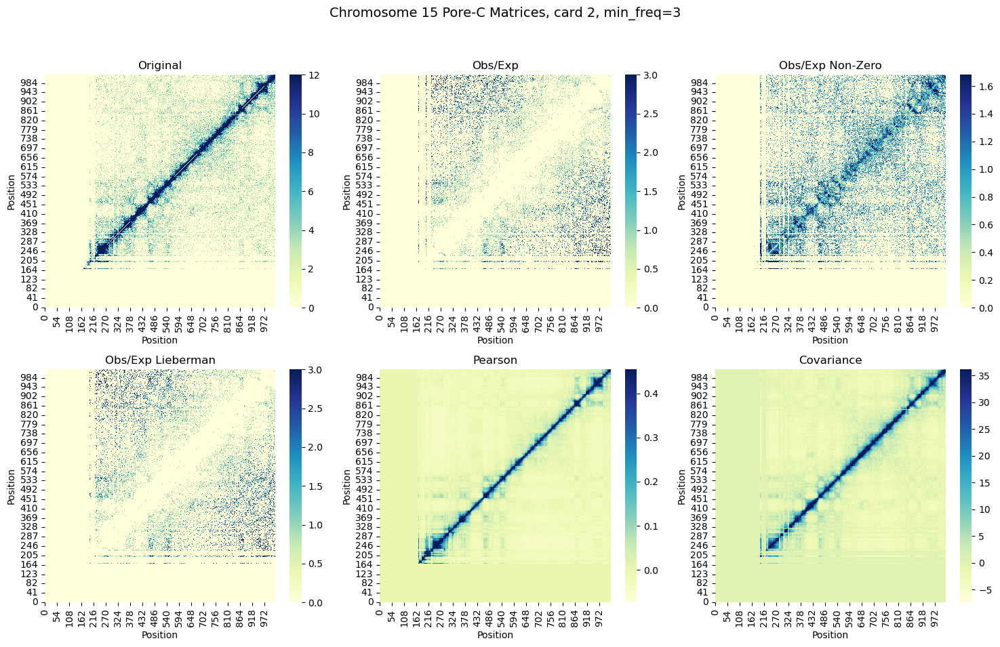

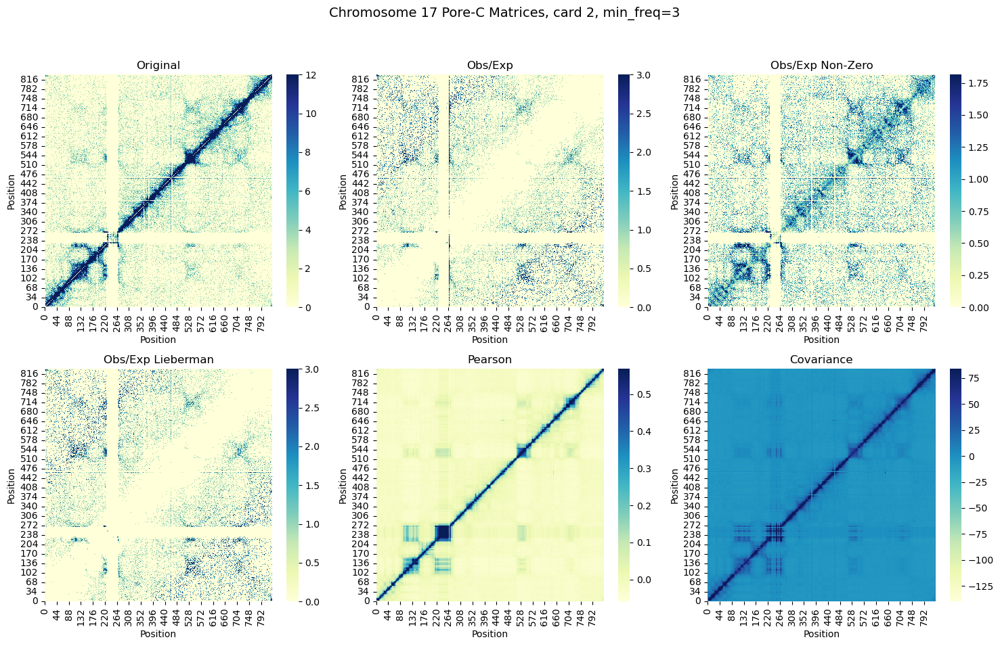

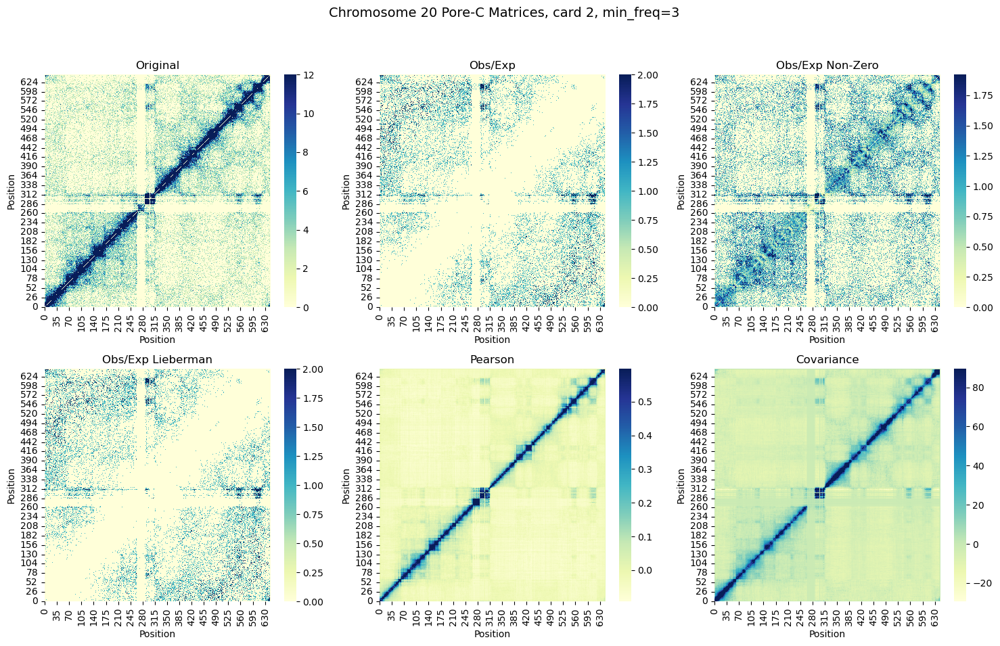

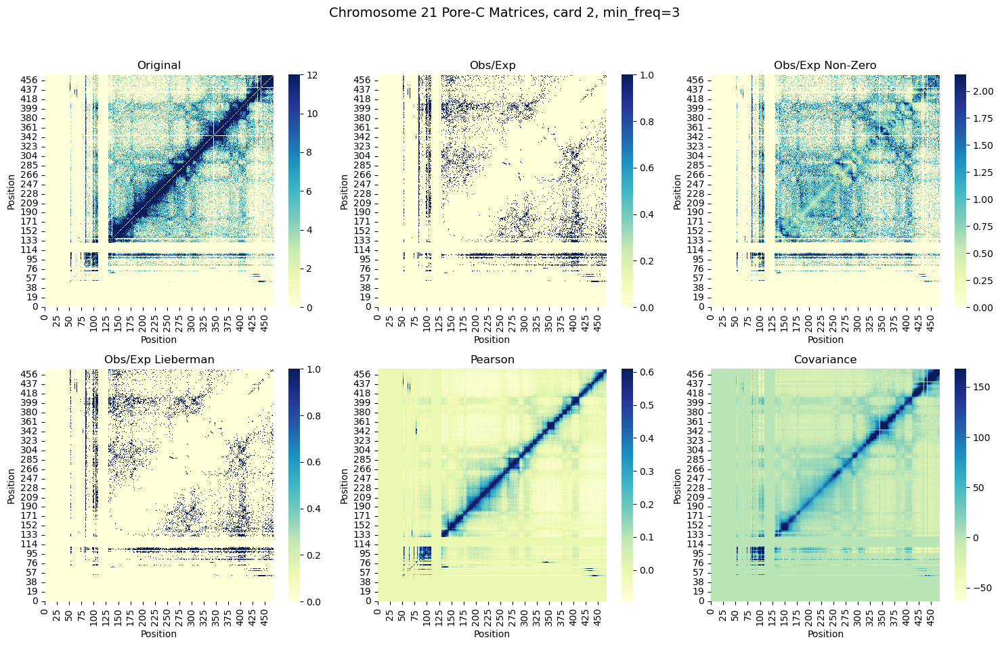

In [17]:
for chromosome in chromosomes:
    display_matrices(chromosome, cool_directory_c2_m3, output_base_dir_c2_m3, 3, 12)

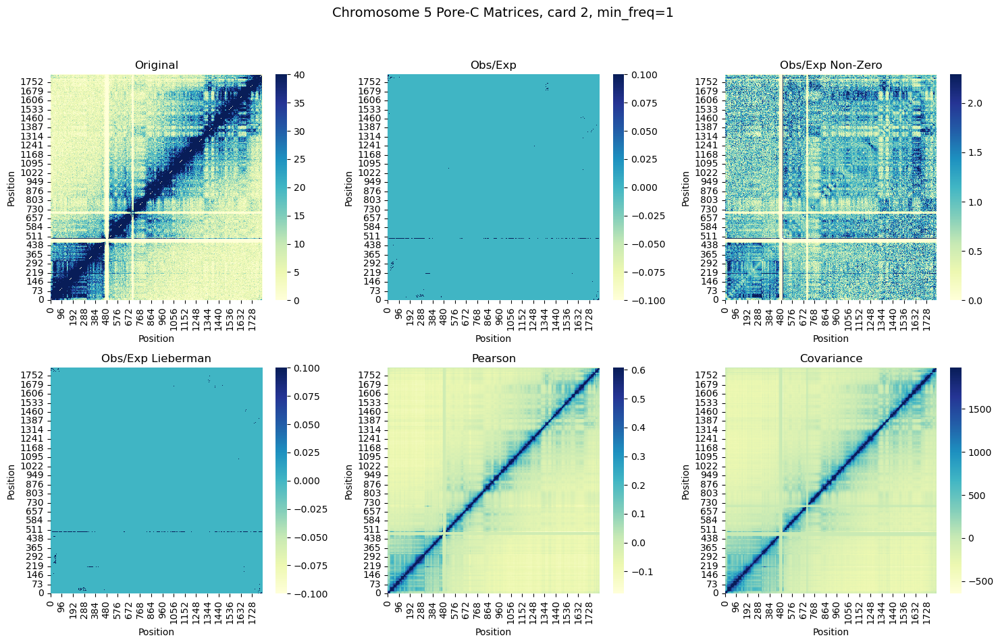

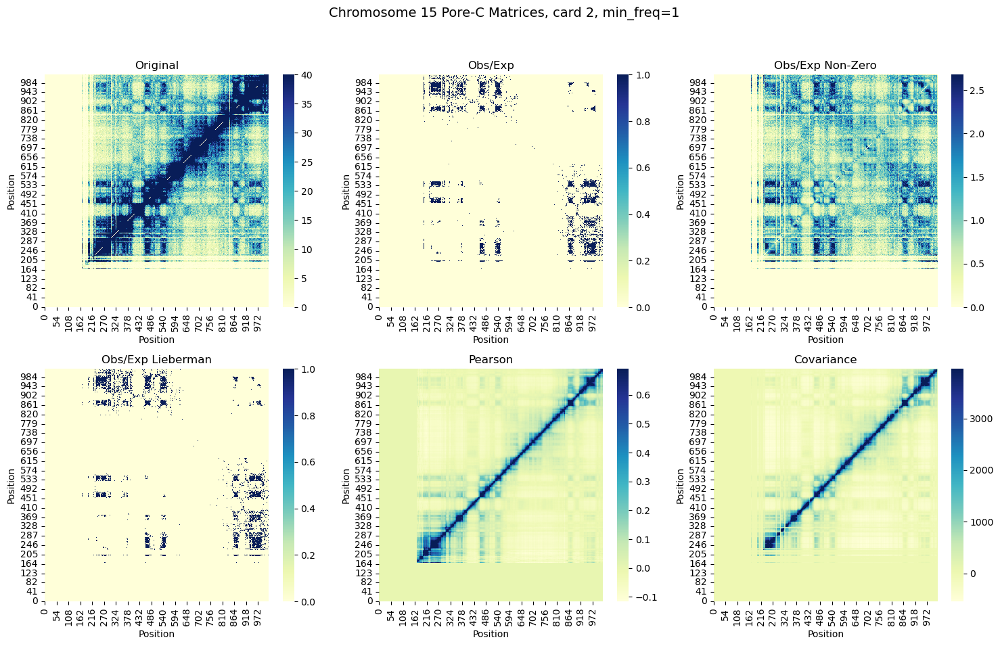

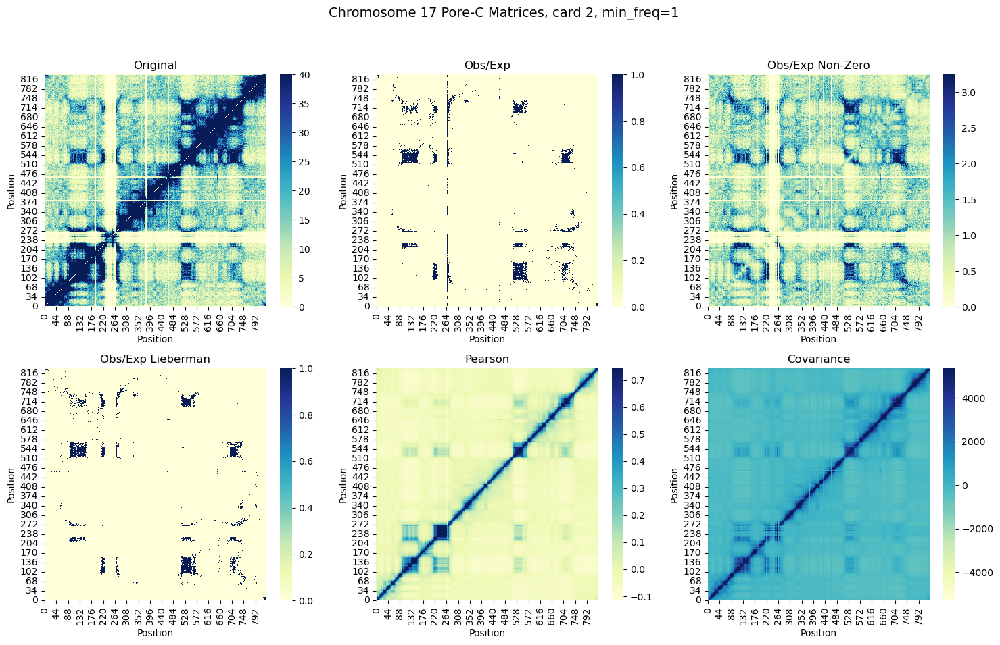

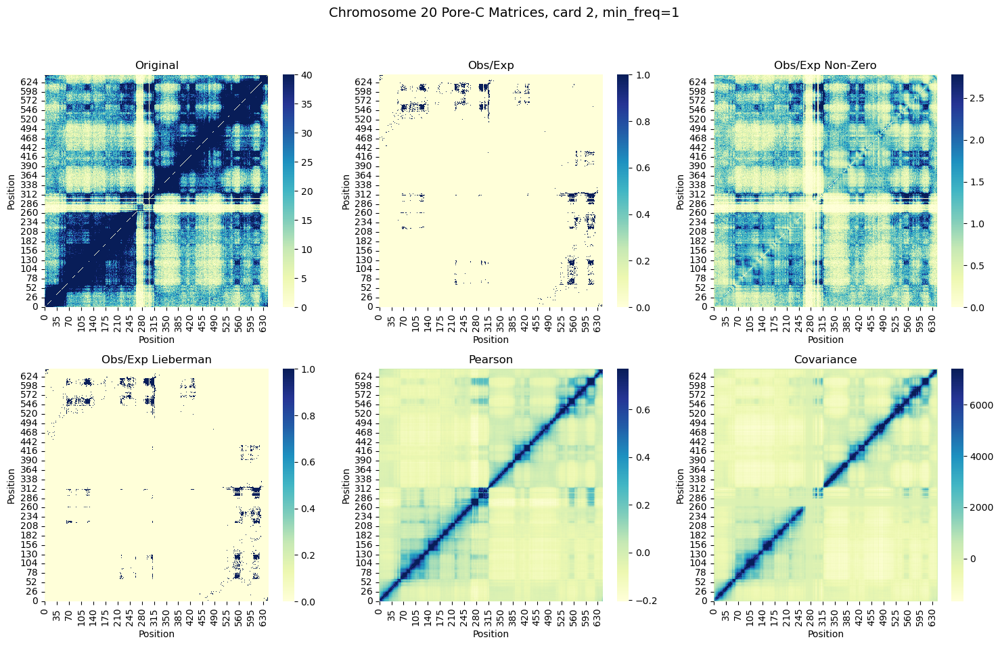

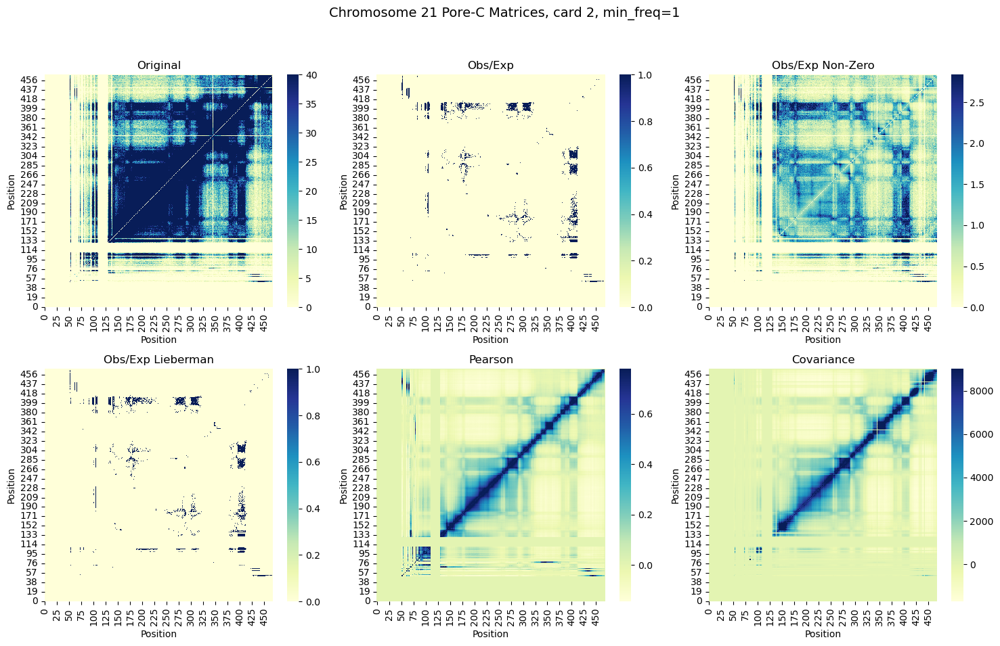

In [20]:
for chromosome in chromosomes:
    display_matrices(chromosome, cool_directory_c2_test, output_base_dir_c2_test, 1, 40)